<a href="https://colab.research.google.com/github/shuvacai/data_science2020/blob/master/faceadv.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 内田先生との meeting メモ
- 注目「しない」特徴量を決めることができないか？（例：服装や髪型等には注目しないなど）
- 可変性の程度で特徴量を区別すべき？（可変性高：髪型や服装、可変性中：肌の色やしわの有無、可変性低：目鼻口の形やほくろの有無、虹彩など）
- シールを貼る攻撃は、そもそも、シールが貼られているということが識別できれば良いのではないか？（シールを剝がすように指示すれば良いだけでは？）
- シールが貼られているということに気が付いたならば、シールを剥がすことを要求すれば良いだけではないか？それができないのであれば、シールを無視すれば良いのではないか？（服装に注目しないのと同じ）
- シールが貼られているということに気が付かず（細工が施されているかどうかをチェックせず）に、「顔」として識別しようとするから攻撃に対して脆弱になるのでは？
- AEのように気が付きにくい攻撃と、シールのように気が付きやすい攻撃がある
- やりたいことは、細工が施された画像であっても正しい識別をしたいことなのか、細工が施された画像を検知したいことなのか、どちらか？
- サイバーセキュリティでいうと、攻撃を検知したいのか（ファイヤーウォール的？）、そもそも攻撃さが無効になるようなシステムを構築したいのか？
- パーツで切ることによって、何を期待しているのか？使う特徴量を限定することで、全体を見ると間違ってしまうものに対して頑健になる？
- パーツで切ることによって、何を犠牲にしているのか？使う特徴量を限定されてしまうことで、全体を見ることによってわかる特徴量を使えなくなる？
- 入力画像にノイズが加えられていることを検知する際の前提条件は？１枚の入力画像だけからノイズの有無を判断しなくてはいけないのか？別途に用意されたクリーンな画像と比較することができるのか？
- 意図的なノイズと、自然のノイズを区別する必要はあるのか？意図的であれ自然であれ、識別結果に影響を- 与えるノイズである場合には問題なのか？問題設定として、自然ノイズは入っていないという前提なのか？
- 男性/女性、といった概念カテゴリを識別するモデルを別途に学習して、それとの総合判断をすればよいのではないか？

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!pip install barbar

In [4]:
!pip install facenet-pytorch

     |████████████████████████████████| 1.9MB 4.2MB/s 


In [5]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.tensorboard import SummaryWriter

import torchvision
import torchvision.transforms as transforms
from torchvision.transforms import ToTensor

import matplotlib.pyplot as plt
import random
import numpy as np
import pandas as pd
import os

from barbar import Bar


# facenet
from facenet_pytorch import MTCNN, InceptionResnetV1
from PIL import Image


%matplotlib inline

In [6]:
PATH = 'drive/MyDrive/Colab Notebooks/research/2021Feb/facialrec'

In [7]:
% cd "drive/MyDrive/Colab Notebooks/research/2021Feb/facialrec"

/content/drive/MyDrive/Colab Notebooks/research/2021Feb/facialrec


In [8]:
mtcnn = MTCNN(image_size=160, margin=10)
# vgg face 2 で pretrained されたモデル
resnet = InceptionResnetV1(pretrained='vggface2').eval()

In [9]:
# 画像の一部を黒塗りする
def cutout(image_origin, region):
    image = np.copy(image_origin)
    mask_value = 0

    _, height, width = image.shape

    if region == "top":
      top = height//2
      left = 0
      bottom = height
      right = width
    elif region == "bottom":
      top = 0
      left = 0
      bottom = height//2
      right = width
    else:
      top = 0
      left = 0
      bottom = 0
      right = width

    # はみ出した場合の処理
    if top < 0:
        top = 0
    if left < 0:
        left = 0
    image[:, top:bottom, left:right].fill(mask_value)
    return torch.from_numpy(image)

In [10]:
# 類似度の関数
def cos_similarity(p1, p2): 
    return np.dot(p1, p2) / (np.linalg.norm(p1) * np.linalg.norm(p2))

In [11]:
# ２つの任意の画像から類似度を出力 cut=0 の時は元の画像
def calc_simillarity(img1, img2, cut=[1,1]):
  # 2 for clopped
  if cut[0]==2:
    img_embedding1 = resnet(img1.unsqueeze(0))
  if cut[1]==2:
    img_embedding2 = resnet(img2.unsqueeze(0))
  # 1 for cutout
  if cut[0]==1:
    img_cropped1 = mtcnn(img1)
    img_embedding1 = resnet(img_cropped1.unsqueeze(0))
  if cut[1]==1:
    img_cropped2 = mtcnn(img2)
    img_embedding2 = resnet(img_cropped2.unsqueeze(0))
    # 0 for original
  if cut[0]==0:
    img_embedding1 = resnet(ToTensor()(img1).unsqueeze(0))
  if cut[1]==0:
    img_embedding2 = resnet(ToTensor()(img2).unsqueeze(0))

  p1 = img_embedding1.squeeze().to('cpu').detach().numpy().copy()
  p2 = img_embedding2.squeeze().to('cpu').detach().numpy().copy()
  img1vs2 = cos_similarity(p1, p2)

  return(img1vs2)

In [12]:
import os
name_list = os.listdir("./TALFW")

print("datasize of AE: ", len(name_list))

datasize of AE:  4281


In [13]:
! cat data/pairs.txt | head -15

10	300
Abel_Pacheco	1	4
Akhmed_Zakayev	1	3
Akhmed_Zakayev	2	3
Amber_Tamblyn	1	2
Anders_Fogh_Rasmussen	1	3
Anders_Fogh_Rasmussen	1	4
Angela_Bassett	1	5
Angela_Bassett	2	5
Angela_Bassett	3	4
Ann_Veneman	3	5
Ann_Veneman	6	10
Ann_Veneman	10	11
Anthony_Fauci	1	2
Antony_Leung	1	2


In [14]:
"""import pandas as pd
pairs_map = []
with open("data/pairs.txt") as fp:
  pairs_tmp = fp.read().split("\n")

for line in pairs_tmp:
  pairs_map.append(line.split("\t"))
pairs_map = pd.DataFrame(pairs_map)
pairs_map
"""

'import pandas as pd\npairs_map = []\nwith open("data/pairs.txt") as fp:\n  pairs_tmp = fp.read().split("\n")\n\nfor line in pairs_tmp:\n  pairs_map.append(line.split("\t"))\npairs_map = pd.DataFrame(pairs_map)\npairs_map\n'

In [15]:
# split into negative and positive pairs
"""pos_pairs = []
neg_pairs = []
for i in range(1, len(pairs_map)):
  if pairs_map.iloc[i, 3] is None:
    p1 = pairs_map.iloc[i,0] + "_000" + str(pairs_map.iloc[i,1]) + ".jpg"
    p2 = pairs_map.iloc[i, 0] + "_000" + str(pairs_map.iloc[i,2])+ ".jpg"
    pos_pairs.append((p1, p2))
  else:
    p1 = pairs_map.iloc[i, 0] + "_000" + str(pairs_map.iloc[i, 1])+ ".jpg"
    p2 = pairs_map.iloc[i, 2]+ "_000" + str(pairs_map.iloc[i, 3])+ ".jpg"
    neg_pairs.append((p1, p2))"""
  

'pos_pairs = []\nneg_pairs = []\nfor i in range(1, len(pairs_map)):\n  if pairs_map.iloc[i, 3] is None:\n    p1 = pairs_map.iloc[i,0] + "_000" + str(pairs_map.iloc[i,1]) + ".jpg"\n    p2 = pairs_map.iloc[i, 0] + "_000" + str(pairs_map.iloc[i,2])+ ".jpg"\n    pos_pairs.append((p1, p2))\n  else:\n    p1 = pairs_map.iloc[i, 0] + "_000" + str(pairs_map.iloc[i, 1])+ ".jpg"\n    p2 = pairs_map.iloc[i, 2]+ "_000" + str(pairs_map.iloc[i, 3])+ ".jpg"\n    neg_pairs.append((p1, p2))'

In [16]:
# save positive pairs in array
"""j = 0
pos_pairs_imgs = []
pos_pairs_labels = []
im1 = None
im2 = None
label1, label2 = None, None
for pairs in pos_pairs:
  img_to_look = pairs[0]
  j+=1
  print(j)
  for name in os.listdir("./TALFW"):
      for img in os.listdir("./TALFW/"+name):
        if img == img_to_look:
          im1 = Image.open("./TALFW/"+name+"/"+img_to_look)
          label1 = name
  img_to_look = pairs[1]
  for name in os.listdir("./TALFW"):
      for img in os.listdir("./TALFW/"+name):
        if img == img_to_look:
          im2 = Image.open("./TALFW/"+name+"/"+img_to_look)
          label2 = name
  if im1 and im2:
    pos_pairs_imgs.append((im1, im2))
    pos_pairs_labels.append((label1, label2))
  im1 = None
  im2 = None"""

'j = 0\npos_pairs_imgs = []\npos_pairs_labels = []\nim1 = None\nim2 = None\nlabel1, label2 = None, None\nfor pairs in pos_pairs:\n  img_to_look = pairs[0]\n  j+=1\n  print(j)\n  for name in os.listdir("./TALFW"):\n      for img in os.listdir("./TALFW/"+name):\n        if img == img_to_look:\n          im1 = Image.open("./TALFW/"+name+"/"+img_to_look)\n          label1 = name\n  img_to_look = pairs[1]\n  for name in os.listdir("./TALFW"):\n      for img in os.listdir("./TALFW/"+name):\n        if img == img_to_look:\n          im2 = Image.open("./TALFW/"+name+"/"+img_to_look)\n          label2 = name\n  if im1 and im2:\n    pos_pairs_imgs.append((im1, im2))\n    pos_pairs_labels.append((label1, label2))\n  im1 = None\n  im2 = None'

In [17]:
# save labels
"""f = open('pos_pair_labels.txt', 'w')
for pair in pos_pairs_labels:
  f.write(pair[0]+","+pair[1]+"\n")"""

'f = open(\'pos_pair_labels.txt\', \'w\')\nfor pair in pos_pairs_labels:\n  f.write(pair[0]+","+pair[1]+"\n")'

In [18]:
# save in directory
"""for i in range(len(pos_pairs_labels)):
  os.mkdir("./data/pos_pairs/"+str(i))
  pos_pairs_imgs[i][0].save("./data/pos_pairs/"+str(i)+"/"+pos_pairs[i][0])
  pos_pairs_imgs[i][1].save("./data/pos_pairs/"+str(i)+"/"+pos_pairs[i][1])"""

'for i in range(len(pos_pairs_labels)):\n  os.mkdir("./data/pos_pairs/"+str(i))\n  pos_pairs_imgs[i][0].save("./data/pos_pairs/"+str(i)+"/"+pos_pairs[i][0])\n  pos_pairs_imgs[i][1].save("./data/pos_pairs/"+str(i)+"/"+pos_pairs[i][1])'

In [19]:
# save negative pairs in array
"""j = 0
neg_pairs_imgs = []
neg_pairs_labels = []
im1 = None
im2 = None
label1, label2 = None, None
for pairs in neg_pairs:
  img_to_look = pairs[0]
  j+=1
  print(j)
  for name in os.listdir("./TALFW"):
      for img in os.listdir("./TALFW/"+name):
        if img == img_to_look:
          im1 = Image.open("./TALFW/"+name+"/"+img_to_look)
          label1 = name
  img_to_look = pairs[1]
  for name in os.listdir("./TALFW"):
      for img in os.listdir("./TALFW/"+name):
        if img == img_to_look:
          im2 = Image.open("./TALFW/"+name+"/"+img_to_look)
          label2 = name
  if im1 and im2:
    neg_pairs_imgs.append((im1, im2))
    neg_pairs_labels.append((label1, label2))
  im1 = None
  im2 = None"""

'j = 0\nneg_pairs_imgs = []\nneg_pairs_labels = []\nim1 = None\nim2 = None\nlabel1, label2 = None, None\nfor pairs in neg_pairs:\n  img_to_look = pairs[0]\n  j+=1\n  print(j)\n  for name in os.listdir("./TALFW"):\n      for img in os.listdir("./TALFW/"+name):\n        if img == img_to_look:\n          im1 = Image.open("./TALFW/"+name+"/"+img_to_look)\n          label1 = name\n  img_to_look = pairs[1]\n  for name in os.listdir("./TALFW"):\n      for img in os.listdir("./TALFW/"+name):\n        if img == img_to_look:\n          im2 = Image.open("./TALFW/"+name+"/"+img_to_look)\n          label2 = name\n  if im1 and im2:\n    neg_pairs_imgs.append((im1, im2))\n    neg_pairs_labels.append((label1, label2))\n  im1 = None\n  im2 = None'

In [20]:
# save labels in directory
"""f = open('neg_pair_labels.txt', 'w')
for pair in neg_pairs_labels:
  f.write(pair[0]+","+pair[1]+"\n")"""

'f = open(\'neg_pair_labels.txt\', \'w\')\nfor pair in neg_pairs_labels:\n  f.write(pair[0]+","+pair[1]+"\n")'

In [21]:
# save images in directory
"""for i in range(len(neg_pairs_labels)):
  os.mkdir("./data/neg_pairs/"+str(i))
  neg_pairs_imgs[i][0].save("./data/neg_pairs/"+str(i)+"/"+neg_pairs[i][0])
  neg_pairs_imgs[i][1].save("./data/neg_pairs/"+str(i)+"/"+neg_pairs[i][1])"""

'for i in range(len(neg_pairs_labels)):\n  os.mkdir("./data/neg_pairs/"+str(i))\n  neg_pairs_imgs[i][0].save("./data/neg_pairs/"+str(i)+"/"+neg_pairs[i][0])\n  neg_pairs_imgs[i][1].save("./data/neg_pairs/"+str(i)+"/"+neg_pairs[i][1])'

In [22]:
#print("images with AE pairs: ", len(pairs_adv))

### load LWF datasets
https://scikit-learn.org/stable/modules/generated/sklearn.datasets.fetch_lfw_people.html#sklearn.datasets.fetch_lfw_people

In [23]:
# load LWF original dataset
from sklearn.datasets import fetch_lfw_people

lfw_people = fetch_lfw_people(color=True, resize=1.0)

lwf_images = lfw_people.images
lwf_target = lfw_people.target
target_names = lfw_people.target_names



In [24]:
lwf_images.shape

(13233, 125, 94, 3)

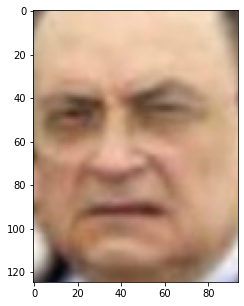

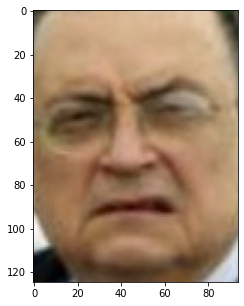

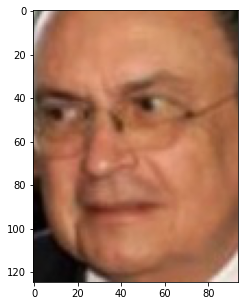

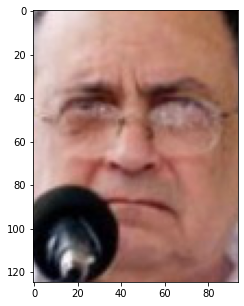

In [25]:
index_name = int(np.where(target_names == "Abel Pacheco")[0])
index_list = np.where(lwf_target==index_name)[0]
for i in index_list:
  fig = plt.figure(figsize=(5,5))
  plt.imshow(lwf_images[i]/255)
  plt.show()

In [26]:
"""# display original images
for i in range(30):
  img1 =lwf_images[i]/255
  img2 = lwf_images[i+1]/255
  simillarity_score = calc_simillarity(img1, img2, 0)
  #simillarily_score2 = calc_simillarity(img1, img2, 1)

  fig = plt.figure(figsize=(10,5))
  ax1 = fig.add_subplot(1, 3, 1)
  plt.title(target_names[lwf_target[i]])
  plt.imshow(img1)
  ax2 = fig.add_subplot(1, 3, 2)
  plt.title(target_names[lwf_target[i+1]])
  plt.imshow(img2)
  ax3 = fig.add_subplot(1, 3, 3)
  plt.text(0.5, 0.5,  [simillarity_score])
  i+=1
  plt.show()"""

'# display original images\nfor i in range(30):\n  img1 =lwf_images[i]/255\n  img2 = lwf_images[i+1]/255\n  simillarity_score = calc_simillarity(img1, img2, 0)\n  #simillarily_score2 = calc_simillarity(img1, img2, 1)\n\n  fig = plt.figure(figsize=(10,5))\n  ax1 = fig.add_subplot(1, 3, 1)\n  plt.title(target_names[lwf_target[i]])\n  plt.imshow(img1)\n  ax2 = fig.add_subplot(1, 3, 2)\n  plt.title(target_names[lwf_target[i+1]])\n  plt.imshow(img2)\n  ax3 = fig.add_subplot(1, 3, 3)\n  plt.text(0.5, 0.5,  [simillarity_score])\n  i+=1\n  plt.show()'

In [27]:
# load positive labels
pos_pairs_labels = []
with open("pos_pair_labels.txt") as f:
  l = [s.strip() for s in f.readlines()]
for pairs in l:
  pair = pairs.split(',')
  pos_pairs_labels.append([pair[0], pair[1]])

print(len(pos_pairs_labels))

2595


In [28]:
# load positive images 
pos_pairs_imgs = []

max_pairs = 300

for i in range(len(pos_pairs_labels)):
  img_names =  os.listdir("./data/pos_pairs/"+str(i))
  img1 = Image.open("./data/pos_pairs/"+str(i)+"/"+img_names[0])
  img2 = Image.open("./data/pos_pairs/"+str(i)+"/"+img_names[1])
  pos_pairs_imgs.append([img1, img2])

In [29]:
# display positive pairs
# 戻す
"""for i in range(30):
  img1 = pos_pairs_imgs[i][0]
  img2 = pos_pairs_imgs[i][1]
  simillarity_score = calc_simillarity(img1, img2, [0,0])
  simillarily_score2 = calc_simillarity(img1, img2, [1,1])

  fig = plt.figure(figsize=(10,5))
  ax1 = fig.add_subplot(1, 3, 1)
  plt.title(pos_pairs_labels[i][0])
  plt.imshow(img1)
  ax2 = fig.add_subplot(1, 3, 2)
  plt.title(pos_pairs_labels[i][1])
  plt.imshow(img2)
  ax3 = fig.add_subplot(1, 3, 3)
  plt.text(0.5, 0.5,  [simillarity_score, simillarily_score2])
  i+=1
  plt.show()
 
"""

'for i in range(30):\n  img1 = pos_pairs_imgs[i][0]\n  img2 = pos_pairs_imgs[i][1]\n  simillarity_score = calc_simillarity(img1, img2, [0,0])\n  simillarily_score2 = calc_simillarity(img1, img2, [1,1])\n\n  fig = plt.figure(figsize=(10,5))\n  ax1 = fig.add_subplot(1, 3, 1)\n  plt.title(pos_pairs_labels[i][0])\n  plt.imshow(img1)\n  ax2 = fig.add_subplot(1, 3, 2)\n  plt.title(pos_pairs_labels[i][1])\n  plt.imshow(img2)\n  ax3 = fig.add_subplot(1, 3, 3)\n  plt.text(0.5, 0.5,  [simillarity_score, simillarily_score2])\n  i+=1\n  plt.show()\n \n'

In [30]:
"""# display positive pairs with original images

ind_adv = []
for i in range(len(pos_pairs_imgs)):
  img1 = pos_pairs_imgs[i][0]
  img2 = pos_pairs_imgs[i][1]

  img1_label = pos_pairs_labels[i][0].replace("_", " ")
  simillarity_score = calc_simillarity(img1, img2, [0, 0])
  simillarily_score2 = calc_simillarity(img1, img2,[1, 1])
  #fig = plt.figure(figsize=(10,5))
  #ax1 = fig.add_subplot(1, 3, 1)
  #plt.title(pos_pairs_labels[i][0])
  #plt.imshow(img1)
  #ax2 = fig.add_subplot(1, 3, 2)
  #plt.title(pos_pairs_labels[i][1])
  #plt.imshow(img2)
 # ax3 = fig.add_subplot(1, 3, 3)
  #plt.text(0.5, 0.5,  [simillarity_score, simillarily_score2])
  i+=1
  #plt.show()

  index_name = int(np.where(target_names == img1_label)[0])
  index_list = np.where(lwf_target==index_name)[0]
  score1 = []
  score2 = []

  for j in index_list:
    fig = plt.figure(figsize=(5,5))
    img3 = lwf_images[j]/255

    simillarity_score3 = calc_simillarity(img3, img1, [0, 1])
    simillarity_score4 = calc_simillarity(img3, img2, [0, 1])
    score1.append(simillarity_score3)
    score2.append(simillarity_score4) 

    #ax2 = fig.add_subplot(1, 2, 1)
    #plt.imshow(img3)
    #ax3 = fig.add_subplot(1, 2, 2)
    #plt.text(0.5, 0.5,  [simillarity_score3, simillarity_score4])
    #plt.show()
  score1_average = sum(score1)/len(score1)
  score2_average = sum(score2)/len(score2)

  if score1_average < score2_average:
    ind_adv.append(0)
  else:
    ind_adv.append(1)
  print(i)"""




  

'# display positive pairs with original images\n\nind_adv = []\nfor i in range(len(pos_pairs_imgs)):\n  img1 = pos_pairs_imgs[i][0]\n  img2 = pos_pairs_imgs[i][1]\n\n  img1_label = pos_pairs_labels[i][0].replace("_", " ")\n  simillarity_score = calc_simillarity(img1, img2, [0, 0])\n  simillarily_score2 = calc_simillarity(img1, img2,[1, 1])\n  #fig = plt.figure(figsize=(10,5))\n  #ax1 = fig.add_subplot(1, 3, 1)\n  #plt.title(pos_pairs_labels[i][0])\n  #plt.imshow(img1)\n  #ax2 = fig.add_subplot(1, 3, 2)\n  #plt.title(pos_pairs_labels[i][1])\n  #plt.imshow(img2)\n # ax3 = fig.add_subplot(1, 3, 3)\n  #plt.text(0.5, 0.5,  [simillarity_score, simillarily_score2])\n  i+=1\n  #plt.show()\n\n  index_name = int(np.where(target_names == img1_label)[0])\n  index_list = np.where(lwf_target==index_name)[0]\n  score1 = []\n  score2 = []\n\n  for j in index_list:\n    fig = plt.figure(figsize=(5,5))\n    img3 = lwf_images[j]/255\n\n    simillarity_score3 = calc_simillarity(img3, img1, [0, 1])\n    si

In [31]:
"""f = open('pos_pair_adv_labels.txt', 'w')
for i in ind_adv:
  f.write(str(i)+"\n")"""

'f = open(\'pos_pair_adv_labels.txt\', \'w\')\nfor i in ind_adv:\n  f.write(str(i)+"\n")'

In [32]:
pos_pair_adv_labels = []
with open("pos_pair_adv_labels.txt") as fp:
  pos_pair_adv_labels = fp.read().split("\n")

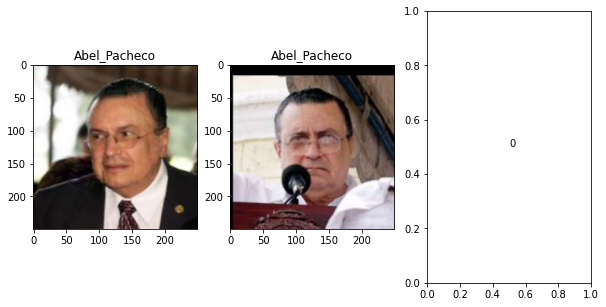

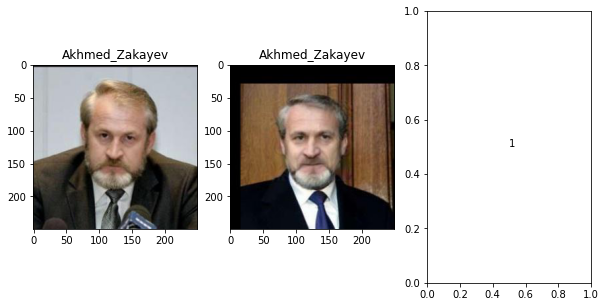

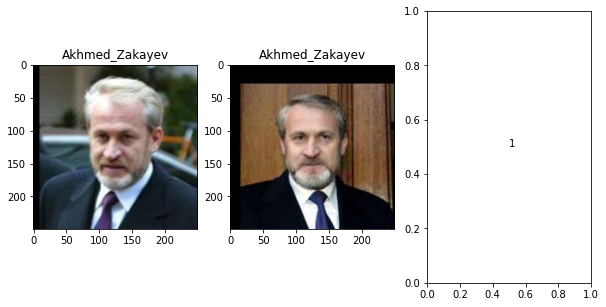

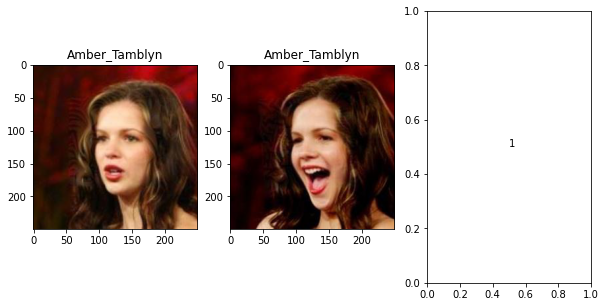

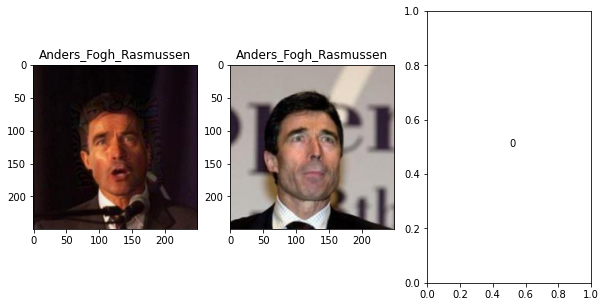

...

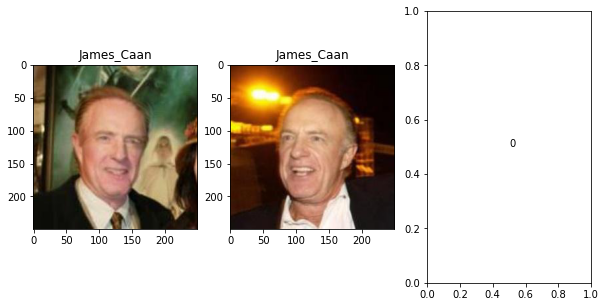

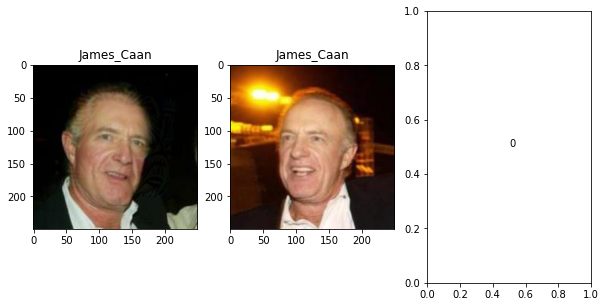

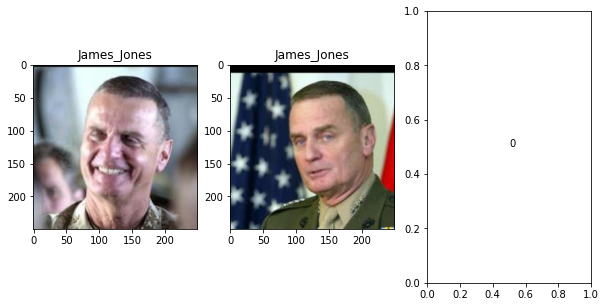

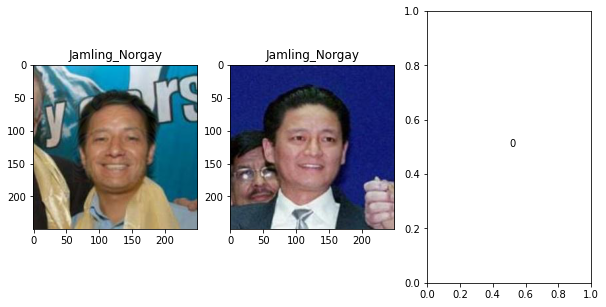

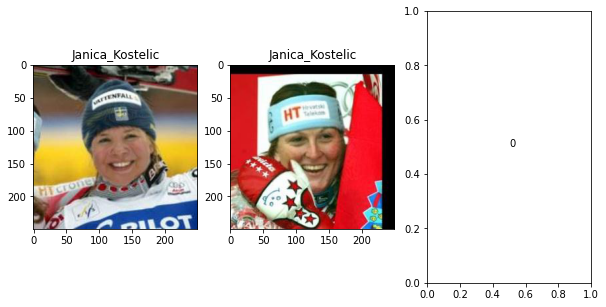

In [33]:
# display positive pairs with adversarial indicator


for i in range(100):
  img1 = pos_pairs_imgs[i][0]
  img2 = pos_pairs_imgs[i][1]

  img1_label = pos_pairs_labels[i][0].replace("_", " ")
  simillarity_score = calc_simillarity(img1, img2, [0, 0])
  simillarily_score2 = calc_simillarity(img1, img2,[1, 1])
  fig = plt.figure(figsize=(10,5))
  ax1 = fig.add_subplot(1, 3, 1)
  plt.title(pos_pairs_labels[i][0])
  plt.imshow(img1)
  ax2 = fig.add_subplot(1, 3, 2)
  plt.title(pos_pairs_labels[i][1])
  plt.imshow(img2)
  ax3 = fig.add_subplot(1, 3, 3)
  plt.text(0.5, 0.5,  pos_pair_adv_labels[i])
  i+=1
  plt.show()


In [34]:
target_names

array(['AJ Cook', 'AJ Lamas', 'Aaron Eckhart', ..., 'Zumrati Juma',
       'Zurab Tsereteli', 'Zydrunas Ilgauskas'], dtype='<U35')

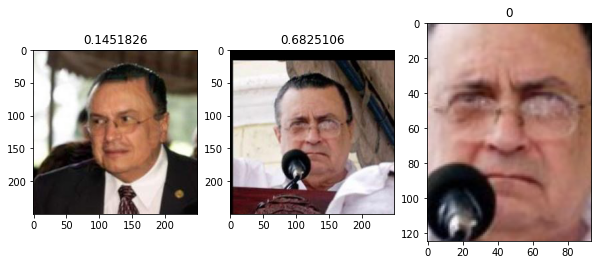

0 (top and bottom):   0.08201331 0.061457682
1 (top and bottom):   0.57314783 0.43126294


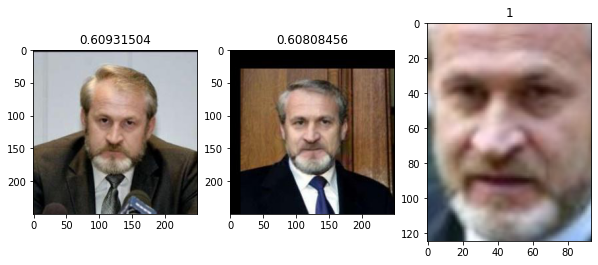

0 (top and bottom):   0.32239714 0.48292124
1 (top and bottom):   0.33387327 0.53038883


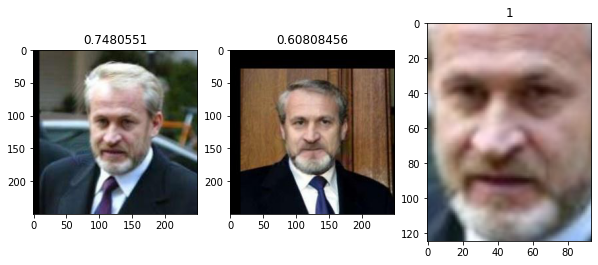

0 (top and bottom):   0.43763408 0.46618348
1 (top and bottom):   0.33387327 0.53038883


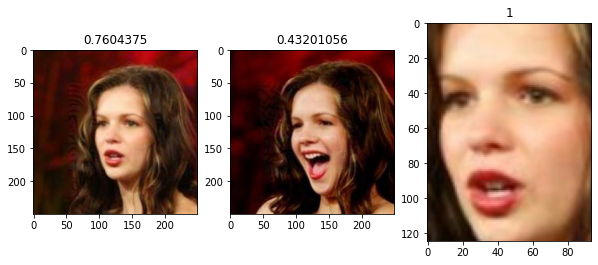

0 (top and bottom):   0.57267815 0.17370136
1 (top and bottom):   0.5502351 -0.013134156


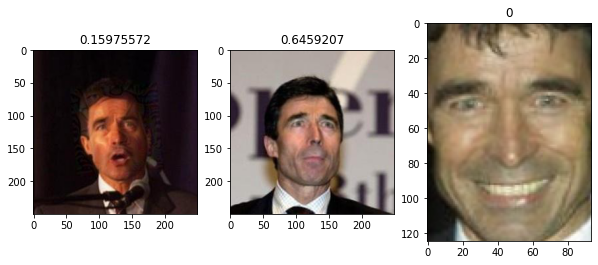

0 (top and bottom):   0.20545484 0.064601846
1 (top and bottom):   0.5175749 0.3228955


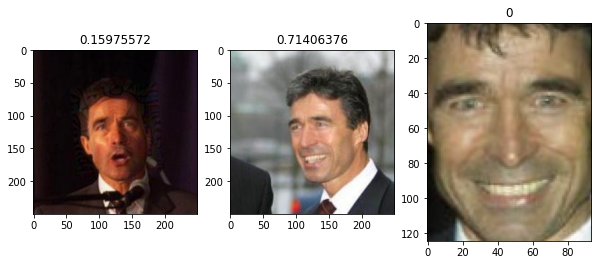

0 (top and bottom):   0.20545484 0.064601846
1 (top and bottom):   0.44086197 0.44848242


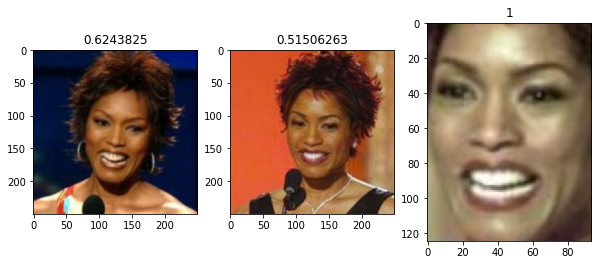

0 (top and bottom):   0.39809918 0.42192852
1 (top and bottom):   0.13856426 0.39216152


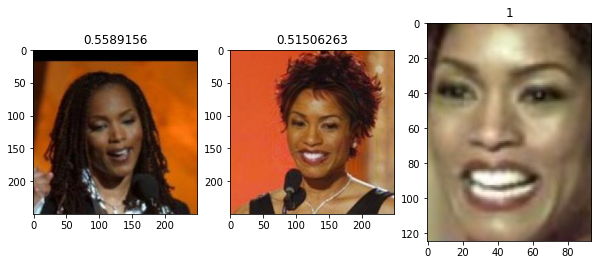

0 (top and bottom):   0.36882973 0.46292958
1 (top and bottom):   0.13856426 0.39216152


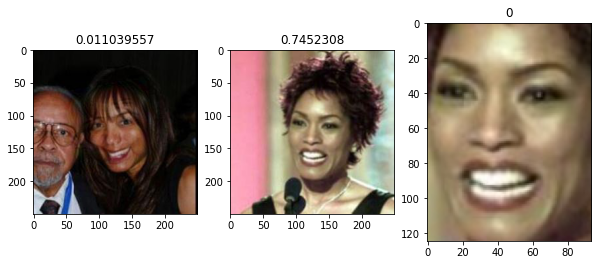

0 (top and bottom):   -0.22046874 -0.036382016
1 (top and bottom):   0.27283502 0.5148477


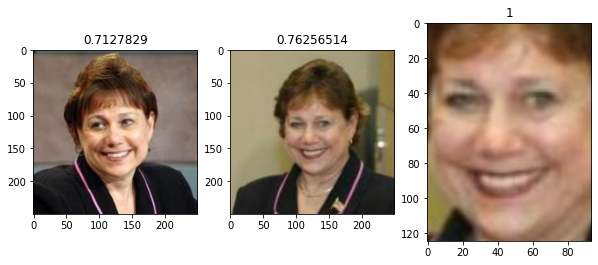

0 (top and bottom):   0.42117333 0.5286727
1 (top and bottom):   0.43786892 0.5125596


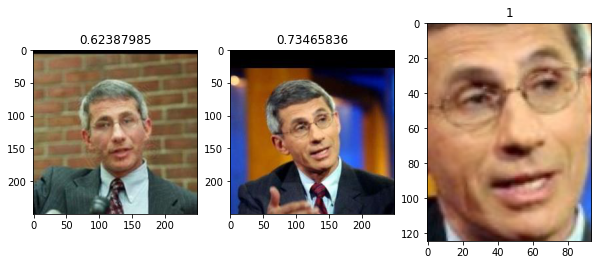

0 (top and bottom):   0.39254844 0.11010503
1 (top and bottom):   0.41157588 0.47185302


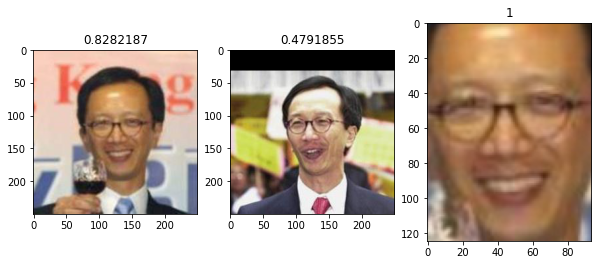

0 (top and bottom):   0.5008135 0.506558
1 (top and bottom):   0.3637412 0.31988296


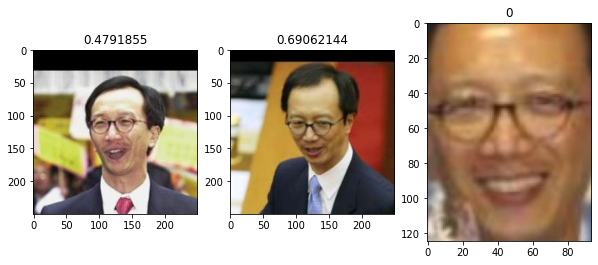

0 (top and bottom):   0.3637412 0.31988296
1 (top and bottom):   0.38960034 0.45463812


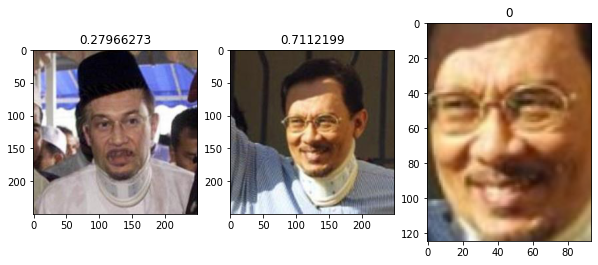

0 (top and bottom):   0.05650775 0.18489401
1 (top and bottom):   0.32356325 0.5478532


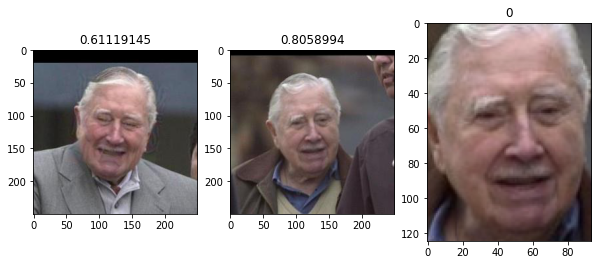

0 (top and bottom):   0.48837805 0.32150924
1 (top and bottom):   0.63878363 0.3632038


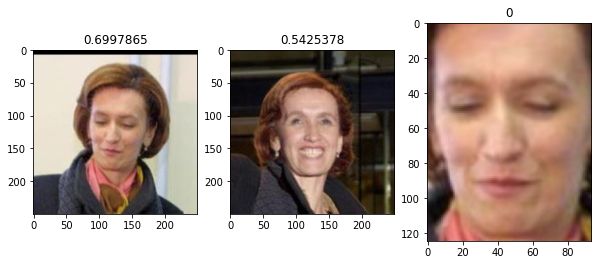

0 (top and bottom):   0.22061568 0.3284022
1 (top and bottom):   0.40165356 0.25228697


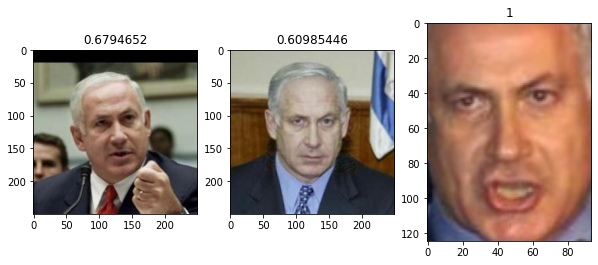

0 (top and bottom):   0.5471843 0.28345308
1 (top and bottom):   0.5716382 0.009288023


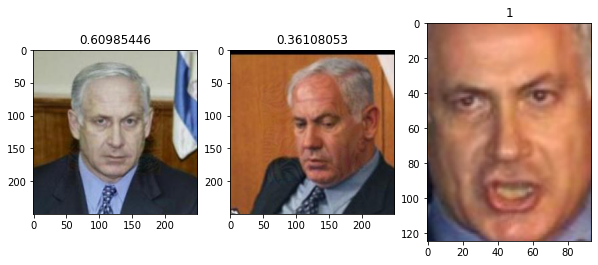

0 (top and bottom):   0.5716382 0.009288023
1 (top and bottom):   0.31553417 0.16322625


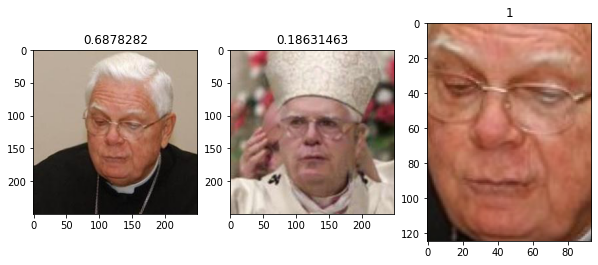

0 (top and bottom):   0.2502617 0.5621562
1 (top and bottom):   0.008518669 -0.023048751


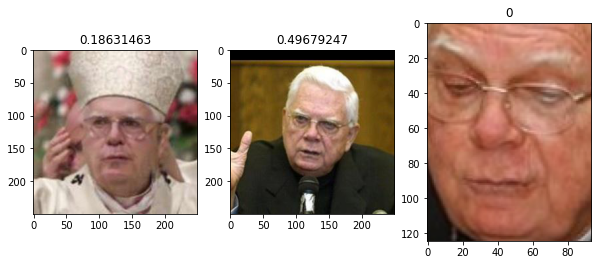

0 (top and bottom):   0.008518669 -0.023048751
1 (top and bottom):   0.08680731 0.52068585


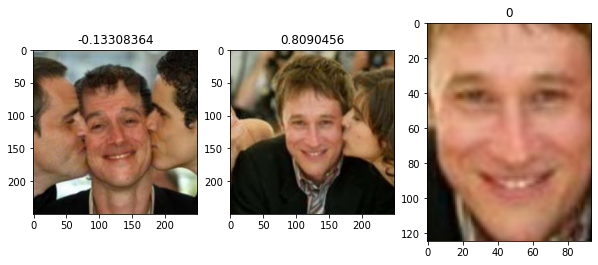

0 (top and bottom):   -0.20322123 0.062359437
1 (top and bottom):   0.45704496 0.36915466


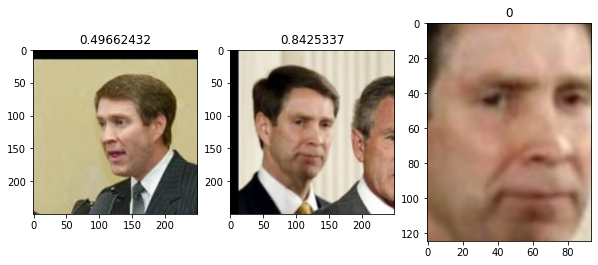

0 (top and bottom):   0.46508858 0.28499582
1 (top and bottom):   0.63469005 0.44535577


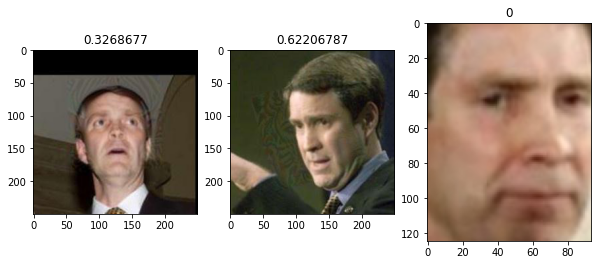

0 (top and bottom):   0.39861742 0.00070047565
1 (top and bottom):   0.49199972 0.41756666


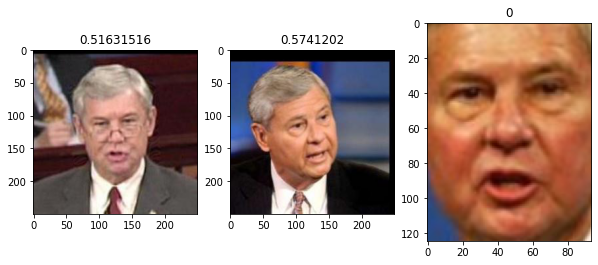

0 (top and bottom):   0.35760203 0.40561506
1 (top and bottom):   0.39438242 0.47277433


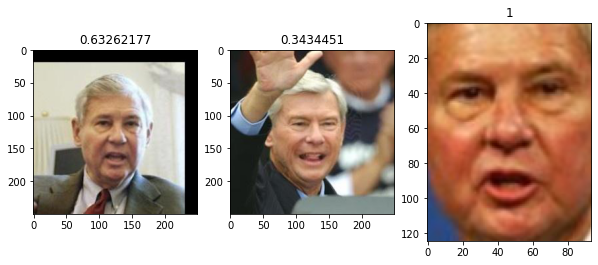

0 (top and bottom):   0.3672926 0.3709222
1 (top and bottom):   0.30963477 0.07527042


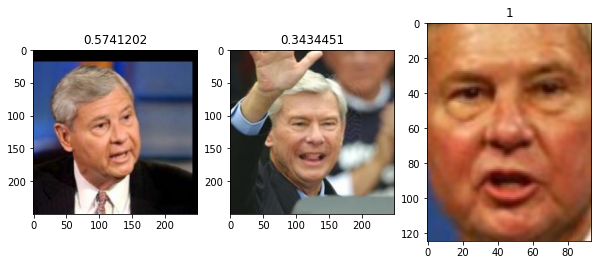

0 (top and bottom):   0.39438242 0.47277433
1 (top and bottom):   0.30963477 0.07527042


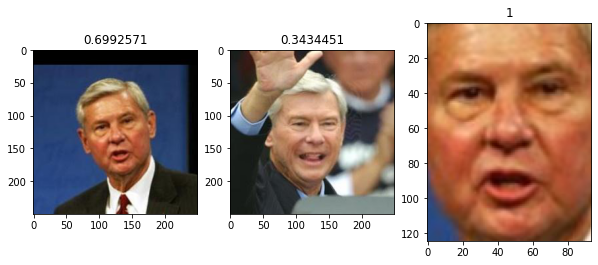

0 (top and bottom):   0.41227227 0.5090551
1 (top and bottom):   0.30963477 0.07527042


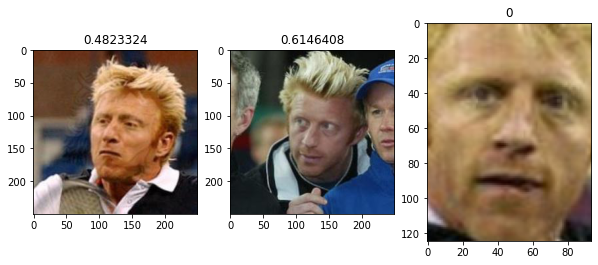

0 (top and bottom):   0.40103692 0.17902596
1 (top and bottom):   0.47424227 0.13102078


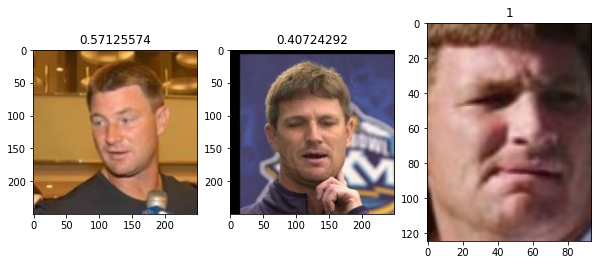

0 (top and bottom):   0.39510342 0.5125492
1 (top and bottom):   0.4486986 0.20453432


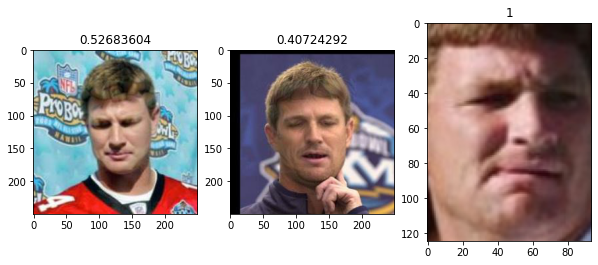

0 (top and bottom):   0.39829943 0.44859314
1 (top and bottom):   0.4486986 0.20453432


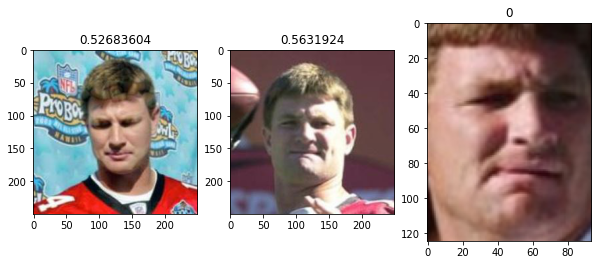

0 (top and bottom):   0.39829943 0.44859314
1 (top and bottom):   0.46454763 0.20110774


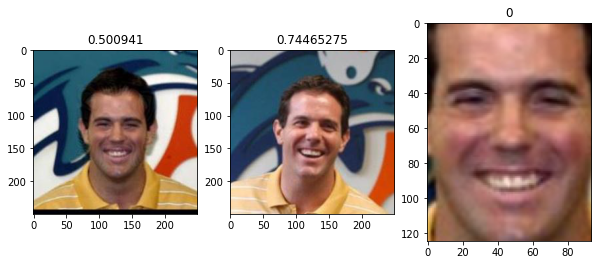

0 (top and bottom):   0.27636147 0.34054744
1 (top and bottom):   0.35119337 0.41933548


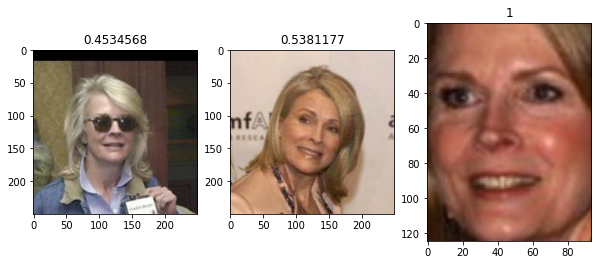

0 (top and bottom):   0.055941887 0.36225227
1 (top and bottom):   0.37830386 0.31127438


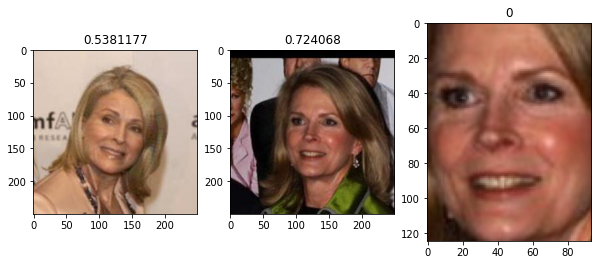

0 (top and bottom):   0.37830386 0.31127438
1 (top and bottom):   0.45291695 0.14393963


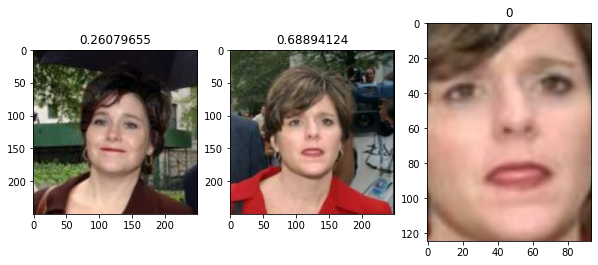

0 (top and bottom):   0.16513218 -0.034659903
1 (top and bottom):   0.33531407 0.14666437


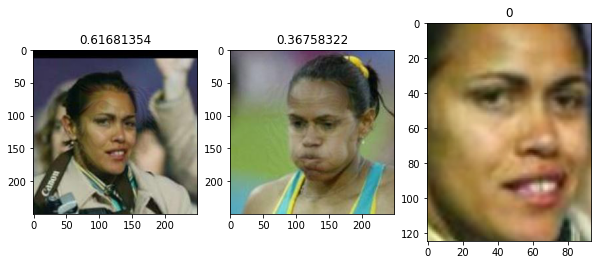

0 (top and bottom):   0.46957067 0.3405115
1 (top and bottom):   0.38582438 0.10319301


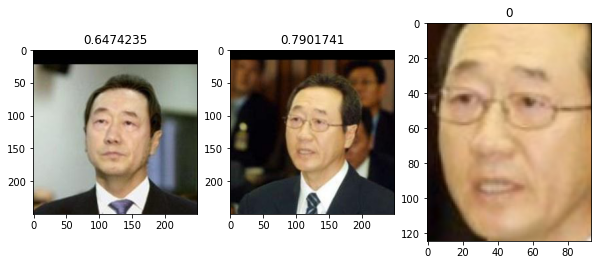

0 (top and bottom):   0.60785884 0.1901122
1 (top and bottom):   0.69742185 0.28458485


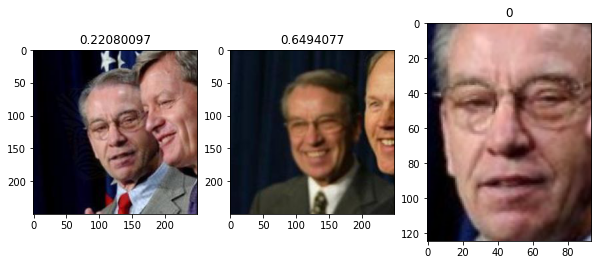

0 (top and bottom):   0.12808587 0.02312392
1 (top and bottom):   0.4510346 0.13898645


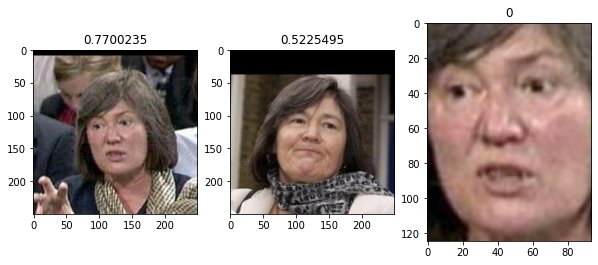

0 (top and bottom):   0.6005151 0.30959517
1 (top and bottom):   0.38745868 0.17004763


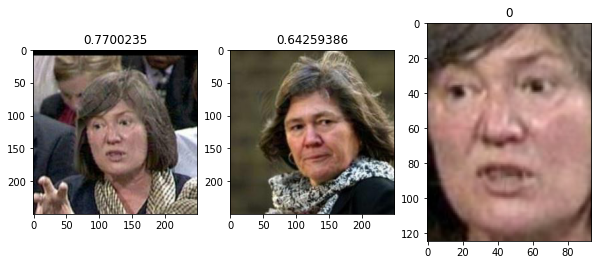

0 (top and bottom):   0.6005151 0.30959517
1 (top and bottom):   0.5212215 0.35138956


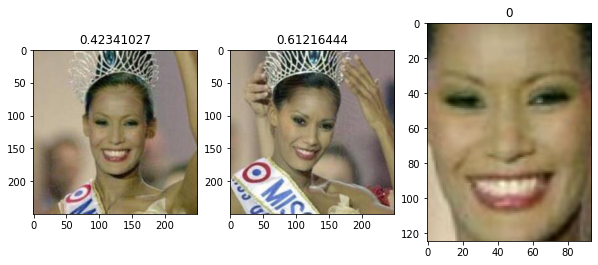

0 (top and bottom):   0.38539326 0.4168415
1 (top and bottom):   0.49097025 0.46039575


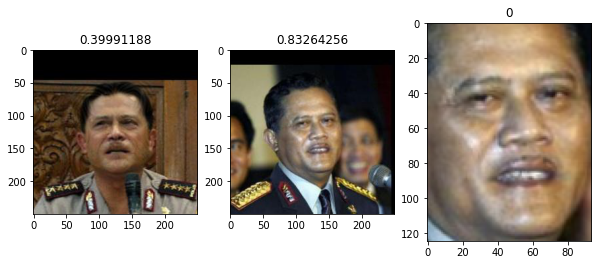

0 (top and bottom):   0.31947106 0.36525518
1 (top and bottom):   0.583812 0.5386657


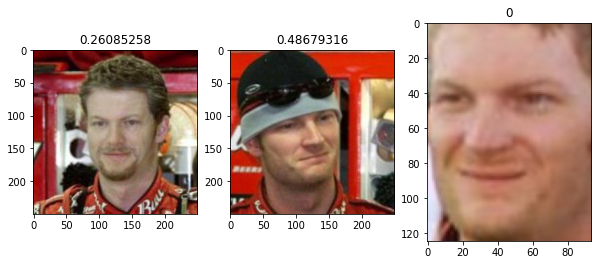

0 (top and bottom):   0.46538243 -0.1871578
1 (top and bottom):   0.35771537 0.3499862


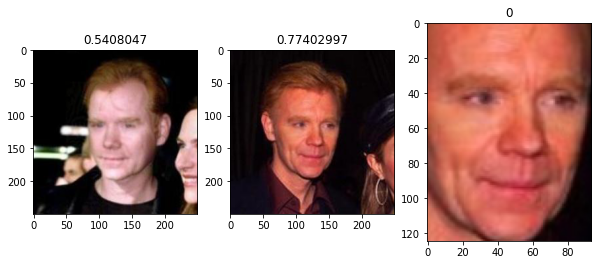

0 (top and bottom):   0.28710565 0.31862327
1 (top and bottom):   0.4473367 0.58518064


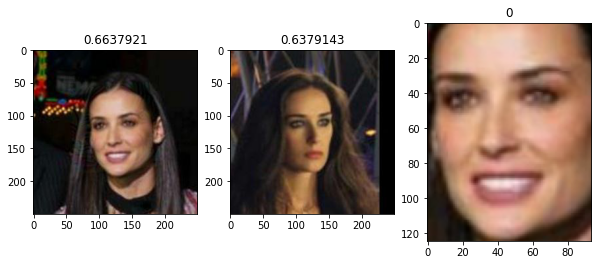

0 (top and bottom):   0.43144584 0.24568664
1 (top and bottom):   0.49951556 0.12194668


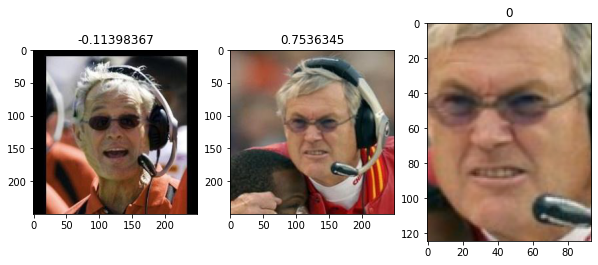

0 (top and bottom):   0.051753398 -0.06930266
1 (top and bottom):   0.5041391 0.50854415


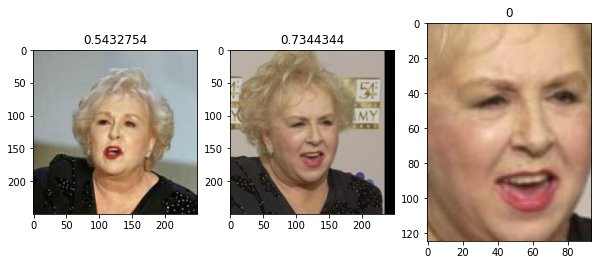

0 (top and bottom):   0.35535628 0.43625543
1 (top and bottom):   0.60396814 0.608174


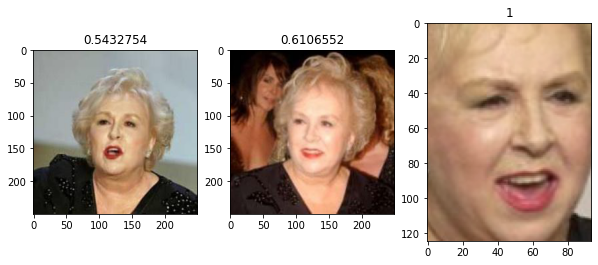

0 (top and bottom):   0.35535628 0.43625543
1 (top and bottom):   0.3576181 0.52112764


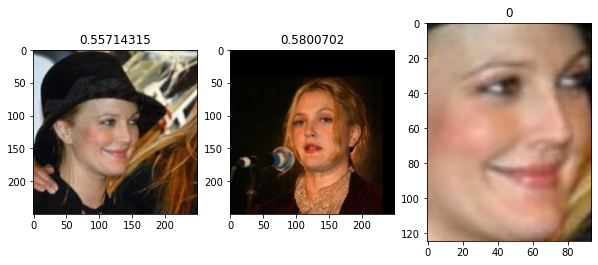

0 (top and bottom):   0.34805128 0.2535111
1 (top and bottom):   0.27061862 0.2967983


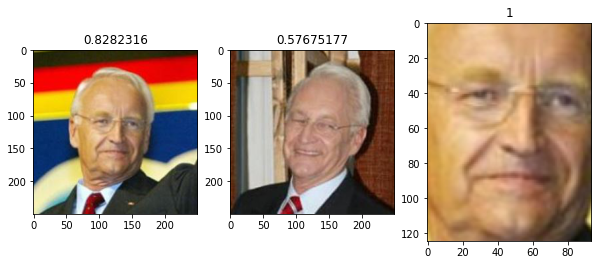

0 (top and bottom):   0.41287526 0.558185
1 (top and bottom):   0.13287668 0.43367016


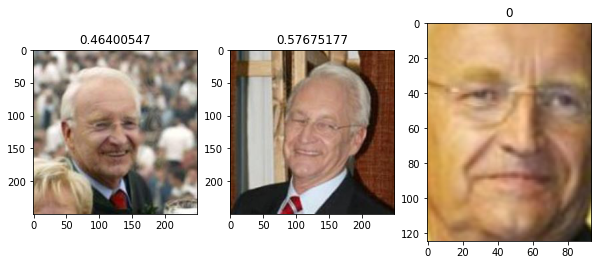

0 (top and bottom):   0.19001156 0.34613347
1 (top and bottom):   0.13287668 0.43367016


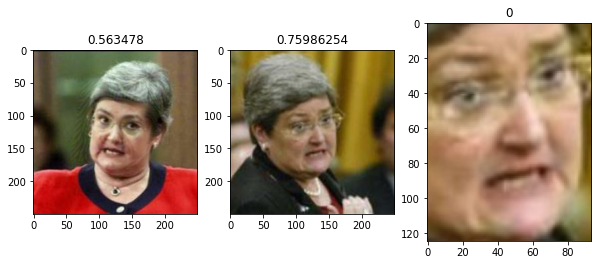

0 (top and bottom):   0.067690566 0.53813356
1 (top and bottom):   0.38204587 0.6711406


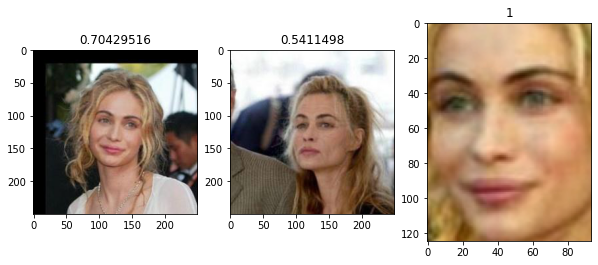

0 (top and bottom):   0.600948 0.21555473
1 (top and bottom):   0.294994 0.13542727


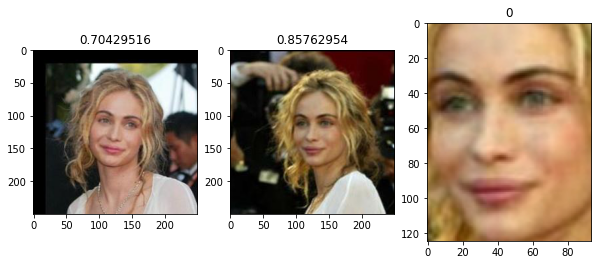

0 (top and bottom):   0.600948 0.21555473
1 (top and bottom):   0.6820372 0.30188018


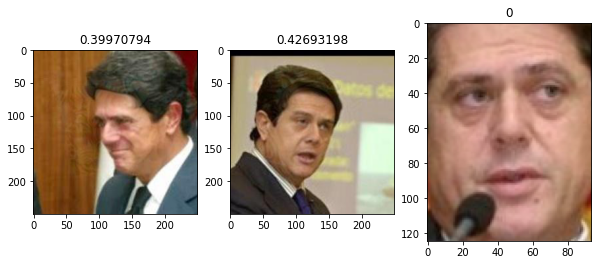

0 (top and bottom):   0.34840876 0.17903432
1 (top and bottom):   0.4582654 0.026606409


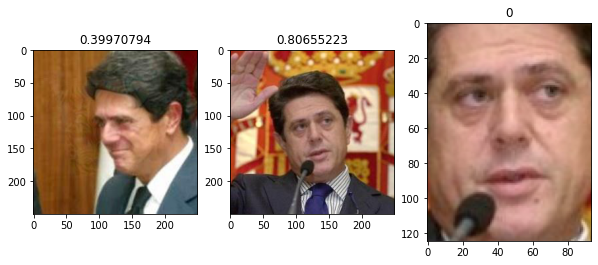

0 (top and bottom):   0.34840876 0.17903432
1 (top and bottom):   0.64255124 0.3026392


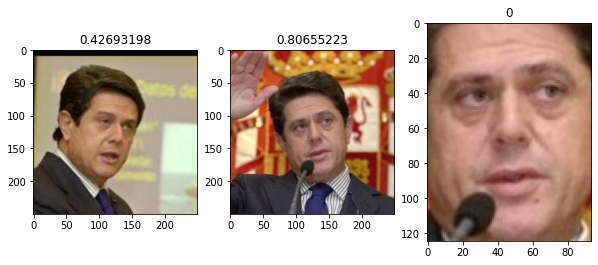

0 (top and bottom):   0.4582654 0.026606409
1 (top and bottom):   0.64255124 0.3026392


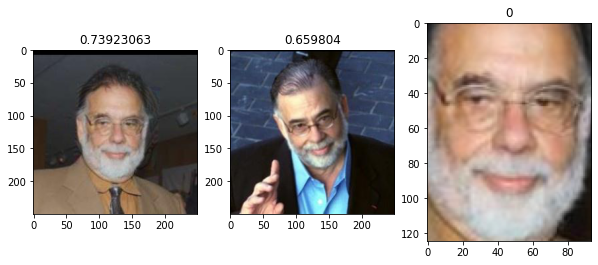

0 (top and bottom):   0.41646346 0.60207033
1 (top and bottom):   0.4474749 0.45789942


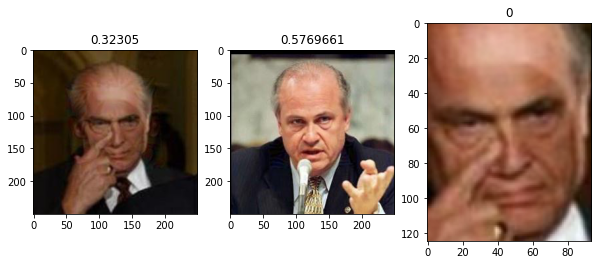

0 (top and bottom):   0.2702804 0.1075379
1 (top and bottom):   0.45732665 0.22187148


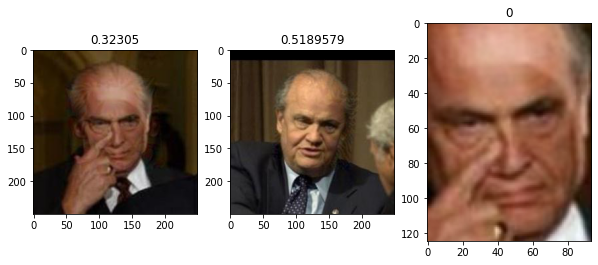

0 (top and bottom):   0.2702804 0.1075379
1 (top and bottom):   0.39389992 0.1562011


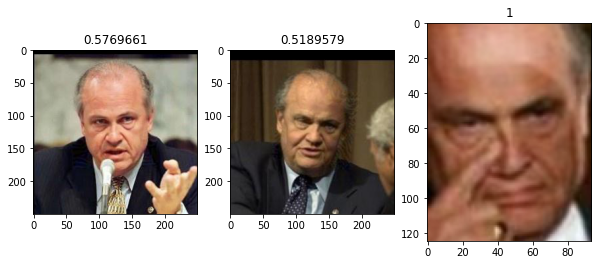

0 (top and bottom):   0.45732665 0.22187148
1 (top and bottom):   0.39389992 0.1562011


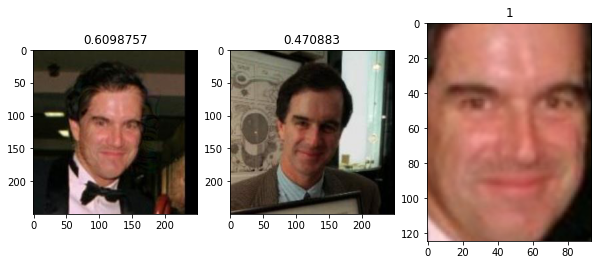

0 (top and bottom):   0.48405385 0.24575552
1 (top and bottom):   0.40439424 0.22770417


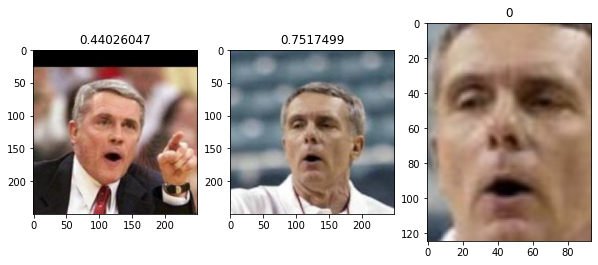

0 (top and bottom):   0.38194603 0.009343656
1 (top and bottom):   0.513691 0.37222508


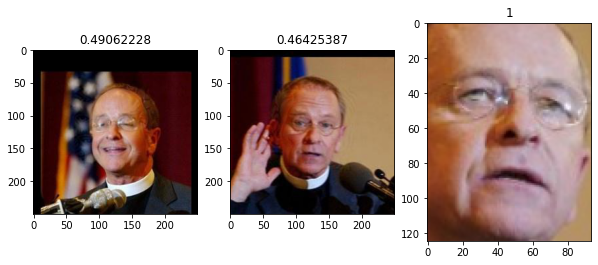

0 (top and bottom):   0.21045318 0.31653634
1 (top and bottom):   0.15682851 0.3893191


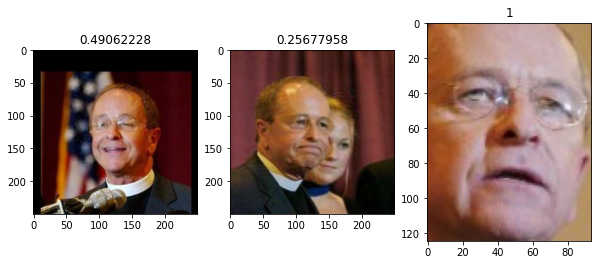

0 (top and bottom):   0.21045318 0.31653634
1 (top and bottom):   0.3518242 0.16428348


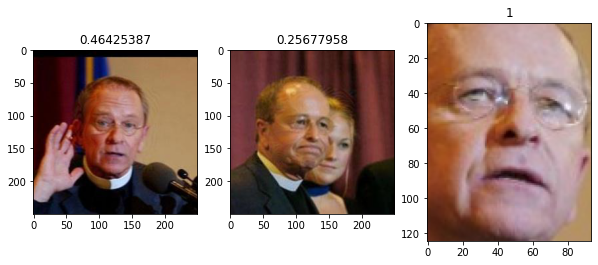

0 (top and bottom):   0.15682851 0.3893191
1 (top and bottom):   0.3518242 0.16428348


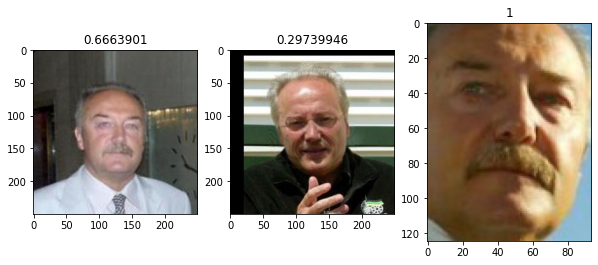

0 (top and bottom):   0.49254087 0.47680205
1 (top and bottom):   0.2702004 0.1392578


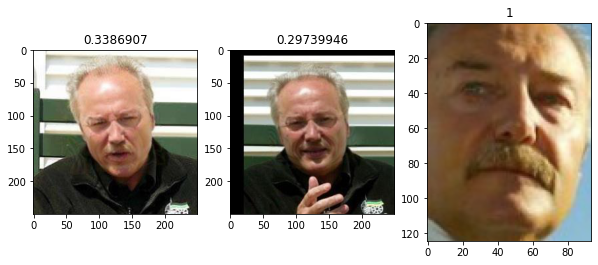

0 (top and bottom):   0.23621744 0.18977502
1 (top and bottom):   0.2702004 0.1392578


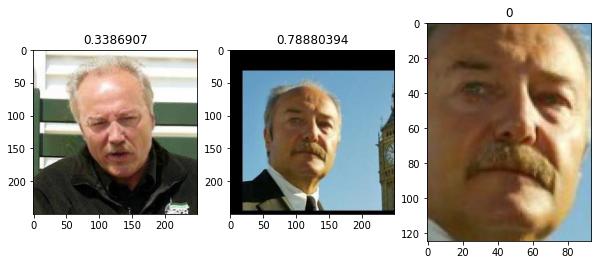

0 (top and bottom):   0.23621744 0.18977502
1 (top and bottom):   0.5046679 0.46038276


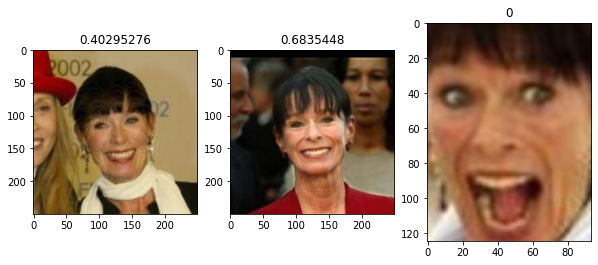

0 (top and bottom):   0.2563534 -0.11353476
1 (top and bottom):   0.40787145 0.5577954


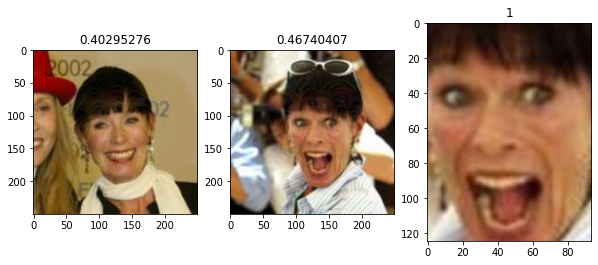

0 (top and bottom):   0.2563534 -0.11353476
1 (top and bottom):   0.075346574 0.43429896


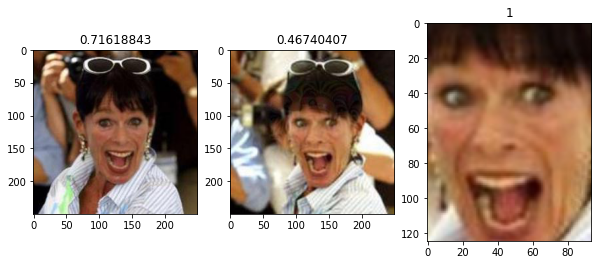

0 (top and bottom):   0.44000533 0.3324816
1 (top and bottom):   0.075346574 0.43429896


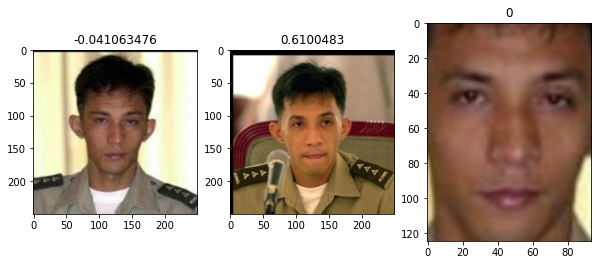

0 (top and bottom):   -0.07008366 0.044968415
1 (top and bottom):   0.4278472 0.31719747


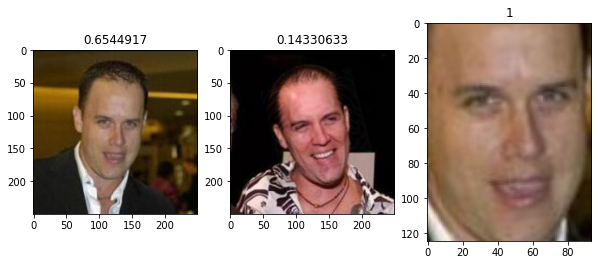

0 (top and bottom):   0.62787086 0.16252957
1 (top and bottom):   0.26886064 0.046040487


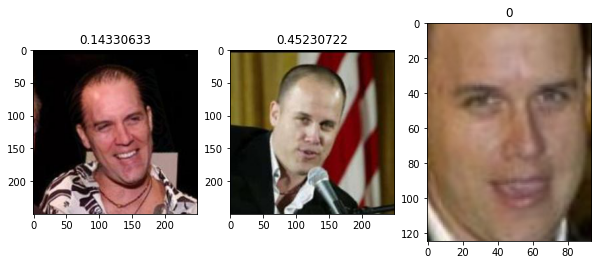

0 (top and bottom):   0.26886064 0.046040487
1 (top and bottom):   0.4282654 0.07241195


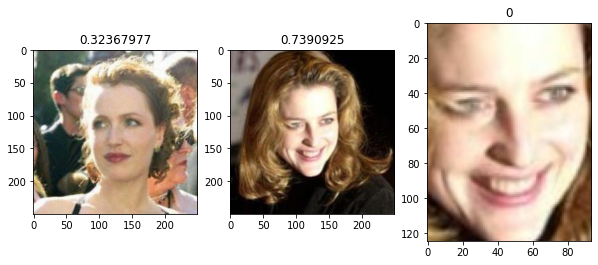

0 (top and bottom):   0.11836153 0.28139085
1 (top and bottom):   0.37028703 0.40889785


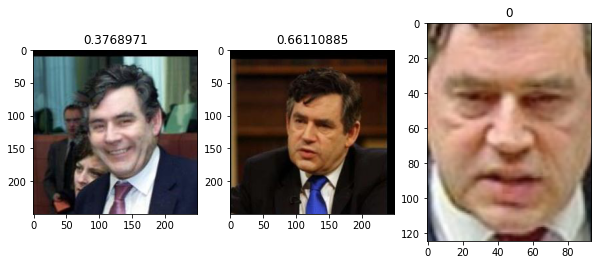

0 (top and bottom):   0.3327219 0.008134059
1 (top and bottom):   0.4580446 0.29329324


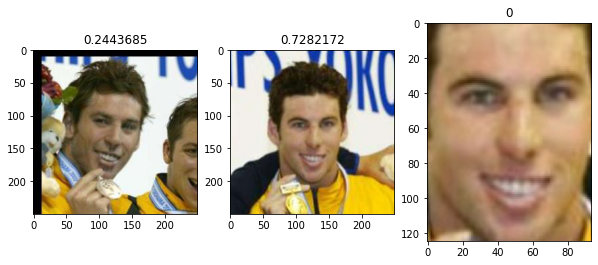

0 (top and bottom):   -0.01889539 0.23070163
1 (top and bottom):   0.51750803 0.41605467


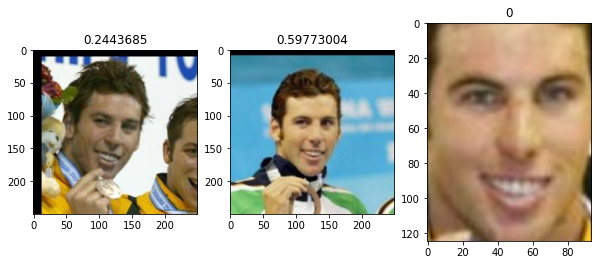

0 (top and bottom):   -0.01889539 0.23070163
1 (top and bottom):   0.39445642 0.3930227


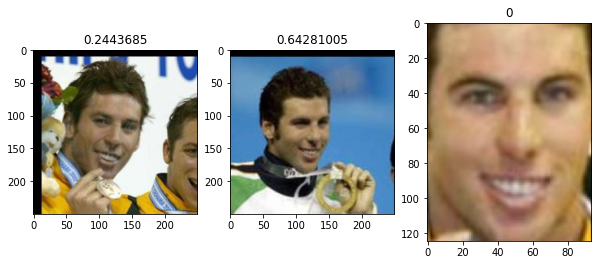

0 (top and bottom):   -0.01889539 0.23070163
1 (top and bottom):   0.32985553 0.3902845


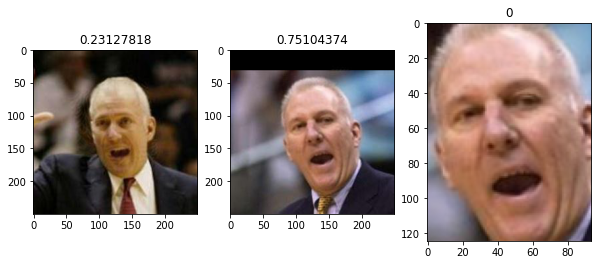

0 (top and bottom):   0.20701154 0.049337212
1 (top and bottom):   0.52920353 0.3031079


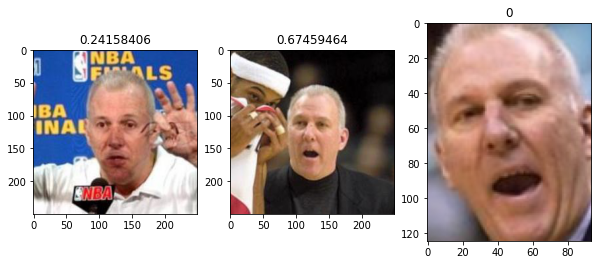

0 (top and bottom):   0.2374632 0.07663068
1 (top and bottom):   0.4557811 0.4281542


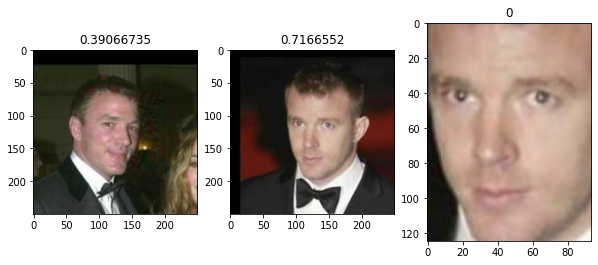

0 (top and bottom):   0.3116924 0.1783802
1 (top and bottom):   0.42850164 0.40398175


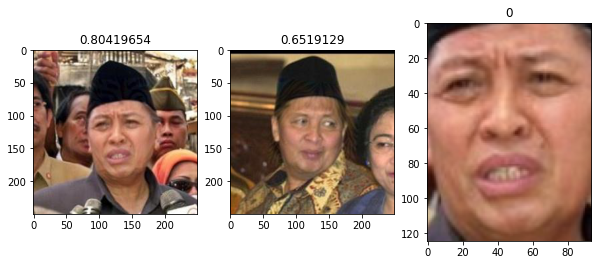

0 (top and bottom):   0.56262064 0.3598764
1 (top and bottom):   0.48472044 0.43224534


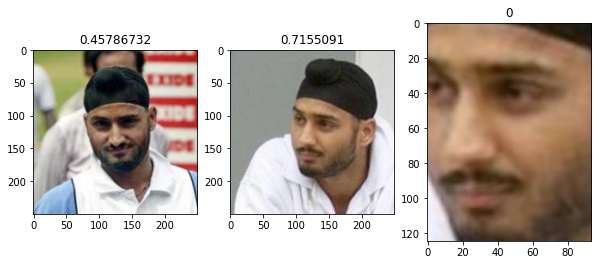

0 (top and bottom):   0.10616217 0.41108677
1 (top and bottom):   0.25176552 0.6387271


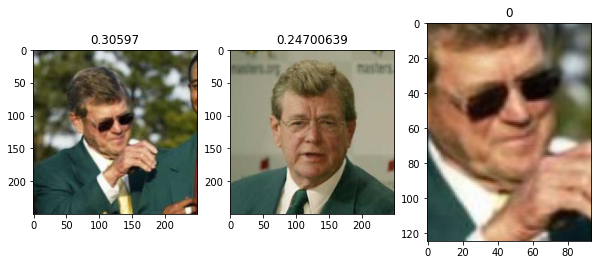

0 (top and bottom):   0.15196471 0.25543648
1 (top and bottom):   0.16150403 0.39860946


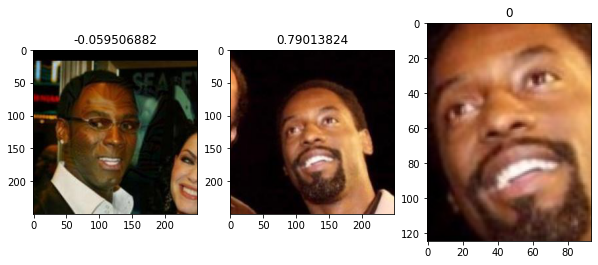

0 (top and bottom):   0.03434358 -0.1549872
1 (top and bottom):   0.40280312 0.56276613


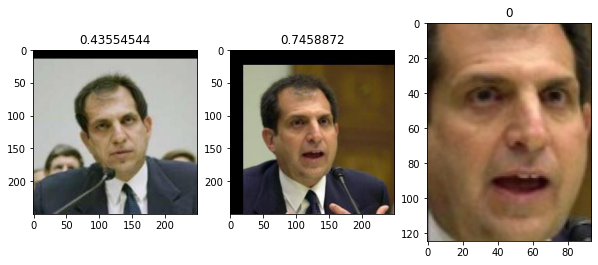

0 (top and bottom):   0.51530564 0.059374273
1 (top and bottom):   0.6982866 0.2947196


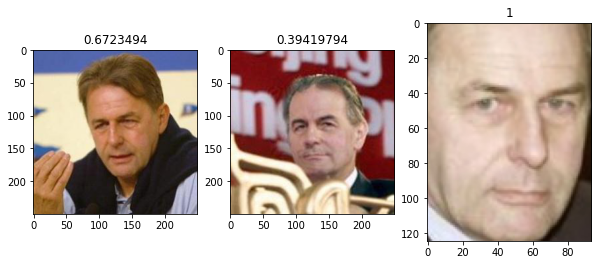

0 (top and bottom):   0.5188106 0.4599352
1 (top and bottom):   0.23217031 0.3913953


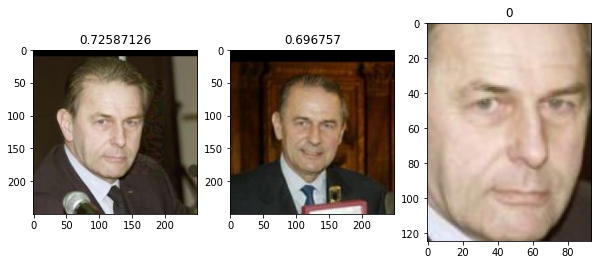

0 (top and bottom):   0.50298464 0.43849272
1 (top and bottom):   0.48168048 0.42435983


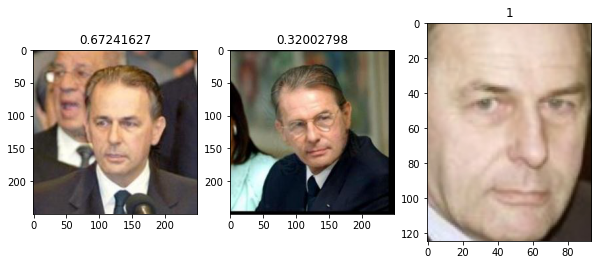

0 (top and bottom):   0.60630256 0.41742906
1 (top and bottom):   0.005847362 0.47041008


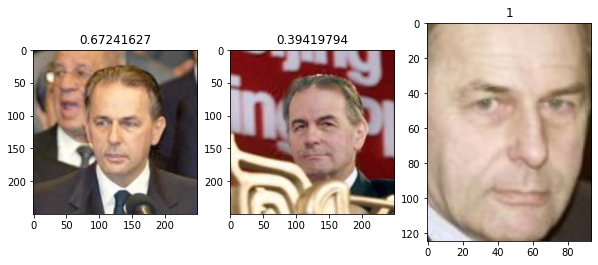

0 (top and bottom):   0.60630256 0.41742906
1 (top and bottom):   0.23217031 0.3913953


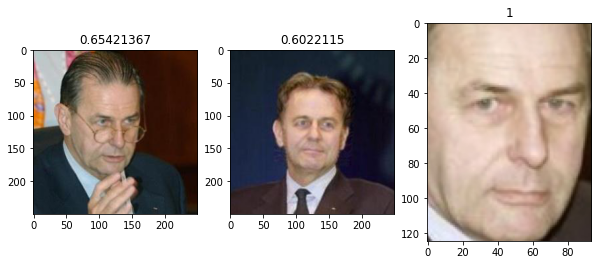

0 (top and bottom):   0.47104093 0.30219302
1 (top and bottom):   0.49585295 0.24811338


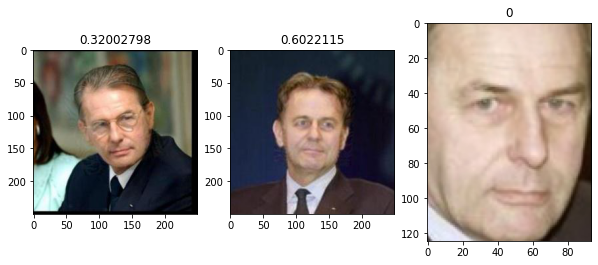

0 (top and bottom):   0.005847362 0.47041008
1 (top and bottom):   0.49585295 0.24811338


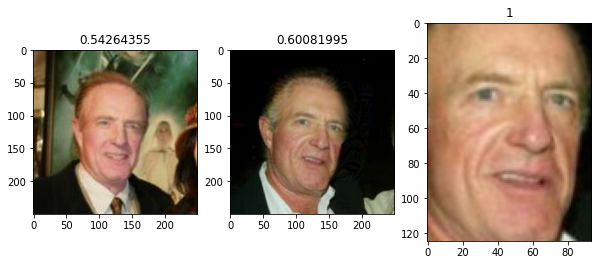

0 (top and bottom):   0.32131144 0.29079458
1 (top and bottom):   0.39921433 0.15936056


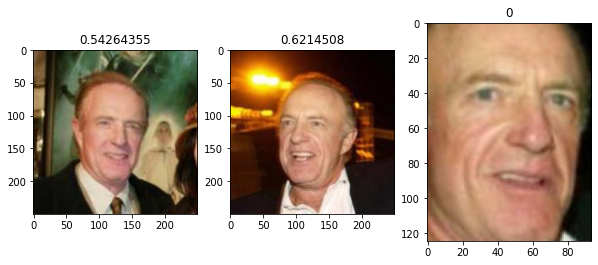

0 (top and bottom):   0.32131144 0.29079458
1 (top and bottom):   0.4365336 0.43462005


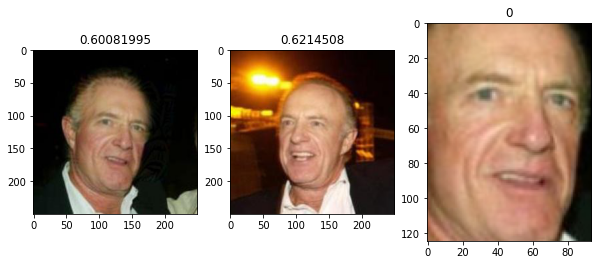

0 (top and bottom):   0.39921433 0.15936056
1 (top and bottom):   0.4365336 0.43462005


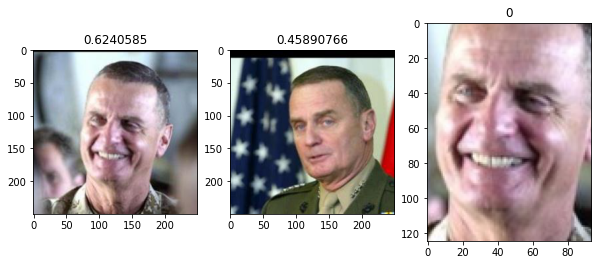

0 (top and bottom):   0.20577802 0.13424537
1 (top and bottom):   0.36709413 0.26691067


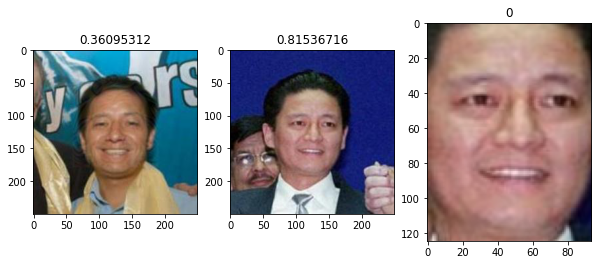

0 (top and bottom):   0.45210043 0.05671325
1 (top and bottom):   0.6644759 0.37766287


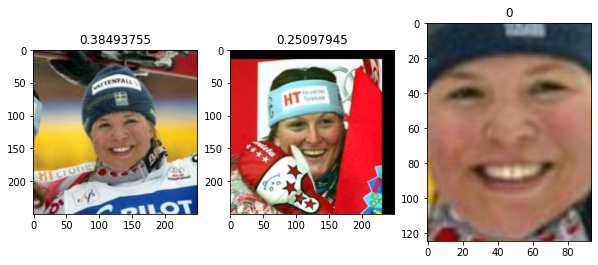

0 (top and bottom):   0.40295574 0.22632578
1 (top and bottom):   0.31428242 0.22185172


In [35]:
# get simillarity score for plane and ae



for i in range(100):
  img1 = pos_pairs_imgs[i][0]
  img2 = pos_pairs_imgs[i][1]

  # clopping into parts
  img_clopped1 = mtcnn(img1)
  img_clopped1_t = cutout(img_clopped1, "top")
  img_clopped1_b = cutout(img_clopped1, "bottom")
  img_clopped2 = mtcnn(img2)
  img_clopped2_t = cutout(img_clopped2, "top")
  img_clopped2_b = cutout(img_clopped2, "bottom")

  # LFW dataset labels
  index_name = int(np.where(target_names == pos_pairs_labels[i][0].replace("_", " "))[0])
  ind = np.where(lwf_target==index_name)[0][-1]

  img3 = lwf_images[ind]/255
  
  img1_label = pos_pairs_labels[i][0].replace("_", " ")
  simillarity_score = calc_simillarity(img3, img1, [0, 1])
  simillarily_score2 = calc_simillarity(img3, img2,[0, 1])

  # clopped image score (top and bottom)
  simillarity_score_c_t = calc_simillarity(img3, img_clopped1_t, [0, 2])
  simillarity_score_c_b = calc_simillarity(img3, img_clopped1_b, [0, 2])
  simillarily_score2_c_t = calc_simillarity(img3, img_clopped2_t,[0, 2])
  simillarily_score2_c_b = calc_simillarity(img3, img_clopped2_b,[0, 2])


  fig = plt.figure(figsize=(10,5))
  ax1 = fig.add_subplot(1, 3, 1)
  plt.title(simillarity_score)
  plt.imshow(img1)
  ax2 = fig.add_subplot(1, 3, 2)
  plt.title(simillarily_score2)
  plt.imshow(img2)
  ax3 = fig.add_subplot(1, 3, 3)
  plt.imshow(img3)
  plt.title(pos_pair_adv_labels[i])
  i+=1
  plt.show()
  print("0 (top and bottom):  ", simillarity_score_c_t, simillarity_score_c_b)
  print("1 (top and bottom):  ", simillarily_score2_c_t, simillarily_score2_c_b)


In [36]:
# load negative labels
neg_pairs_labels = []
with open("neg_pair_labels.txt") as f:
  l = [s.strip() for s in f.readlines()]
for pairs in l:
  pair = pairs.split(',')
  neg_pairs_labels.append([pair[0], pair[1]])

print(neg_pairs_labels)

[['Abdel_Madi_Shabneh', 'Dean_Barker'], ['Abdel_Madi_Shabneh', 'Giancarlo_Fisichella'], ['Abdel_Madi_Shabneh', 'Mikhail_Gorbachev'], ['Abdul_Rahman', 'Portia_de_Rossi'], ['Abel_Pacheco', 'Jong_Thae_Hwa'], ['Abel_Pacheco', 'Jean-Francois_Lemounier'], ['Afton_Smith', 'Dwayne_Wade'], ['Ahmad_Jbarah', 'James_Comey'], ['Akhmed_Zakayev', 'Donna_Morrissey'], ['Alan_Dershowitz', 'Bertrand_Bonello'], ['Alanis_Morissette', 'Martin_Cauchon'], ['Alexander_Lukashenko', 'Heather_Chinnock'], ['Alfonso_Cuaron', 'Jason_Priestley'], ['Alfonso_Cuaron', 'Patty_Schnyder'], ['Alfonso_Soriano', 'Bill_Nelson'], ['Alfonso_Soriano', 'Julio_De_Brun'], ['Alfonso_Soriano', 'Patty_Schnyder'], ['Alonzo_Mourning', 'Cecilia_Cheung'], ['Amber_Tamblyn', 'Benjamin_Netanyahu'], ['Amporn_Falise', 'Joe_Pantoliano'], ['Anders_Fogh_Rasmussen', 'Johnson_Panjaitan'], ['Andre_Bucher', 'Joseph_Ralston'], ['Andre_Bucher', 'Maria_Garcia'], ['Andrew_Gilligan', 'Henry_Castellanos'], ['Andrew_Shutley', 'Edmund_Stoiber'], ['Andrew_Shut

In [ ]:
# load negative images 
neg_pairs_imgs = []

j = 0

for i in range(max_pairs):
  img_names =  os.listdir("./data/neg_pairs/"+str(i))
  img1 = Image.open("./data/neg_pairs/"+str(i)+"/"+img_names[0])
  img2 = Image.open("./data/neg_pairs/"+str(i)+"/"+img_names[1])
  neg_pairs_imgs.append([img1, img2])

In [ ]:
#display negative pairs

for i in range(200):
  img1 = neg_pairs_imgs[i][0]
  img2 = neg_pairs_imgs[i][1]
  simillarity_score = calc_simillarity(img1, img2, [0,0])
  simillarily_score2 = calc_simillarity(img1, img2, [1,1])

  fig = plt.figure(figsize=(10,5))
  ax1 = fig.add_subplot(1, 3, 1)
  plt.title(neg_pairs_labels[i][0])
  plt.imshow(img1)
  ax2 = fig.add_subplot(1, 3, 2)
  plt.title(neg_pairs_labels[i][1])
  plt.imshow(img2)
  ax3 = fig.add_subplot(1, 3, 3)
  plt.text(0.5, 0.5,  [simillarity_score, simillarily_score2])
  i+=1
  plt.show()